# **YOLOv8**

In [ ]:
!nvidia-smi

Wed Apr 10 22:00:07 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0              47W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.4/750.4 kB 10.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/side-body-final'
!ls '/content/drive/My Drive/side-body-final/train'
!ls '/content/drive/My Drive/side-body-final/valid'

Mounted at /content/drive
data.yaml  pretrained-n.pt  test  train  valid
images	labels	labels.cache
images	labels	labels.cache


In [ ]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8n.yaml")
yaml_file = "/content/drive/My Drive/side-body-final/data.yaml"
results = model.train(data=yaml_file, epochs=100, imgsz=320)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/drive/My Drive/side-body-final/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, 

100%|██████████| 755k/755k [00:00<00:00, 79.0MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 342MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/My Drive/side-body-final/train/labels.cache... 1914 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1914/1914 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.04G      3.869      3.539      3.935         55        320: 100%|██████████| 120/120 [02:45<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.52it/s]

                   all        146        423    0.00654      0.199    0.00987    0.00267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.05G      2.929      2.718      3.013         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.96it/s]

                   all        146        423      0.156      0.211      0.106     0.0388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.05G      2.455      2.411       2.58         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.56it/s]

                   all        146        423      0.265       0.35      0.252     0.0904



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.05G      2.211      2.185      2.291         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.73it/s]

                   all        146        423      0.404      0.382      0.349      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.05G      2.076      2.065      2.182         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.65it/s]

                   all        146        423      0.518      0.438      0.426      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.05G      1.971      1.911       2.05         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.85it/s]

                   all        146        423      0.548      0.451      0.479      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.05G      1.922       1.84      2.006         54        320: 100%|██████████| 120/120 [00:10<00:00, 11.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.26it/s]

                   all        146        423      0.562      0.542      0.564       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.05G       1.87      1.771      1.961         81        320: 100%|██████████| 120/120 [00:10<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.50it/s]

                   all        146        423      0.724      0.534      0.626      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.05G      1.817      1.706      1.904         82        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]

                   all        146        423      0.728      0.552      0.633      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.02G      1.793      1.649      1.884         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.81it/s]

                   all        146        423      0.711      0.603      0.671      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.01G      1.746      1.565      1.831         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.91it/s]

                   all        146        423      0.697      0.617      0.693      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.02G      1.732      1.544      1.829         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.78it/s]

                   all        146        423      0.823      0.603       0.72      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.01G        1.7      1.506      1.802         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.72it/s]

                   all        146        423      0.751      0.624      0.707      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.01G      1.688      1.462      1.793         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.08it/s]

                   all        146        423       0.81      0.661      0.744      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.02G      1.658       1.46      1.779         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.94it/s]

                   all        146        423      0.742      0.684      0.736       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.01G      1.643      1.404      1.754         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.13it/s]

                   all        146        423      0.832      0.656      0.761        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.02G      1.632      1.387      1.731         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.42it/s]

                   all        146        423      0.792      0.711      0.769      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.02G      1.636      1.367      1.734         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.47it/s]

                   all        146        423      0.822      0.679      0.775       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.01G      1.603      1.318      1.705         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.30it/s]

                   all        146        423      0.833      0.647      0.763      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.01G      1.593       1.33      1.703         34        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.69it/s]

                   all        146        423      0.833      0.688      0.773      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.01G      1.575      1.285      1.691         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.95it/s]

                   all        146        423       0.85      0.686      0.779      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.01G      1.571      1.272      1.682         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.54it/s]

                   all        146        423      0.799      0.707      0.782      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.02G      1.556      1.253      1.673         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.67it/s]

                   all        146        423      0.875      0.696      0.808      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.01G      1.568      1.249      1.681         73        320: 100%|██████████| 120/120 [00:10<00:00, 11.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]

                   all        146        423      0.823      0.724       0.79      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.01G      1.543       1.24      1.661         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.83it/s]

                   all        146        423      0.855       0.73       0.79      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.01G      1.533      1.191       1.64         58        320: 100%|██████████| 120/120 [00:10<00:00, 11.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.78it/s]

                   all        146        423       0.84      0.732        0.8      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.02G       1.53      1.212      1.654         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423      0.859      0.728      0.794      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.02G      1.509      1.185      1.636         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.71it/s]

                   all        146        423      0.841      0.731      0.797      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.02G      1.516       1.18      1.637         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]

                   all        146        423      0.811      0.697      0.798      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.02G      1.484      1.138      1.605         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.60it/s]

                   all        146        423      0.833      0.725      0.782       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.01G      1.493      1.147      1.605         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.50it/s]

                   all        146        423      0.861      0.725      0.817       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.01G      1.477      1.148      1.599         68        320: 100%|██████████| 120/120 [00:10<00:00, 11.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.95it/s]

                   all        146        423       0.84      0.742      0.815      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.01G      1.483      1.128        1.6         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423      0.851      0.752      0.826      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.02G      1.476      1.121      1.603         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.36it/s]

                   all        146        423      0.871      0.706      0.804      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.01G      1.447       1.11      1.583         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]

                   all        146        423      0.802      0.745      0.801      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.02G      1.456      1.103      1.573         44        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.52it/s]

                   all        146        423      0.848      0.739      0.805      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.01G      1.475      1.107      1.579         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423       0.81      0.754      0.817       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.01G       1.44      1.091      1.567         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.27it/s]


                   all        146        423      0.868      0.731      0.818      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.02G      1.452      1.085      1.572         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.44it/s]

                   all        146        423      0.813      0.773      0.824      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.01G      1.452      1.068      1.577         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.75it/s]

                   all        146        423      0.828      0.764      0.819      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.01G      1.436      1.072      1.562         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.92it/s]

                   all        146        423      0.862      0.734      0.818      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.01G      1.437       1.05      1.552         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.86it/s]

                   all        146        423      0.848      0.749      0.827      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.01G      1.413      1.048      1.547         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.47it/s]

                   all        146        423      0.866      0.739      0.824      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.01G      1.393      1.029      1.551         39        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.61it/s]

                   all        146        423      0.868      0.761      0.834      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.02G      1.393      1.015      1.526         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.77it/s]

                   all        146        423      0.879      0.735      0.818      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.01G      1.394      1.018      1.535         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.27it/s]

                   all        146        423      0.827      0.763      0.829       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.01G      1.392      1.023      1.538         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.24it/s]

                   all        146        423      0.813      0.765      0.824      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.02G      1.378     0.9935      1.516         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.49it/s]

                   all        146        423      0.802      0.762      0.817       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.01G      1.369     0.9831      1.515         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.13it/s]

                   all        146        423      0.833      0.751      0.826      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.01G      1.365     0.9877      1.519         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423      0.853      0.752      0.823      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.01G      1.361     0.9717      1.508         30        320: 100%|██████████| 120/120 [00:10<00:00, 11.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.03it/s]

                   all        146        423      0.915      0.712      0.815      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.01G      1.352     0.9703      1.503         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.77it/s]

                   all        146        423      0.853      0.748      0.828      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.01G      1.352     0.9602      1.485         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.64it/s]

                   all        146        423      0.847      0.753      0.821       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.01G      1.335     0.9468      1.475         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.62it/s]

                   all        146        423      0.838      0.761      0.836      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.02G      1.344     0.9564      1.491         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.29it/s]

                   all        146        423      0.902      0.718      0.818      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.01G      1.329     0.9399      1.483         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.61it/s]

                   all        146        423      0.843      0.742      0.818      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.01G      1.331     0.9455      1.476         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.99it/s]

                   all        146        423      0.859      0.766      0.815      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.01G       1.32     0.9231      1.475         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.36it/s]

                   all        146        423      0.886      0.738      0.822      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.02G      1.313     0.9242      1.463         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.49it/s]

                   all        146        423      0.877      0.761      0.837      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.02G      1.314      0.927      1.458         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.70it/s]

                   all        146        423      0.866      0.738      0.826      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.01G      1.316     0.9366      1.473         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.17it/s]

                   all        146        423      0.897      0.746      0.837      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.02G      1.319     0.9155       1.46         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.28it/s]

                   all        146        423      0.869      0.739      0.814      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.02G      1.282     0.8988      1.447         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.05it/s]

                   all        146        423      0.828      0.758       0.82      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.01G      1.298     0.9064      1.449         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.37it/s]

                   all        146        423      0.873      0.719      0.823      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.01G      1.283     0.8928      1.436         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.86it/s]

                   all        146        423      0.836      0.777      0.826      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.02G      1.276     0.8872       1.44         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]

                   all        146        423      0.856      0.765      0.817      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.02G      1.274     0.8846      1.431         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.86it/s]


                   all        146        423      0.867       0.73      0.817      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.02G      1.258      0.859      1.421         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.45it/s]

                   all        146        423      0.866      0.772      0.827        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.01G       1.26     0.8718      1.423         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.78it/s]

                   all        146        423      0.852      0.752      0.817      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.01G      1.252     0.8621      1.426         36        320: 100%|██████████| 120/120 [00:10<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all        146        423      0.857      0.762      0.819      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.01G      1.263      0.875      1.422         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.77it/s]

                   all        146        423       0.86      0.767      0.831      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.01G      1.264     0.8665      1.414         74        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423      0.871      0.743      0.822      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.01G      1.239     0.8475      1.402         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.49it/s]

                   all        146        423      0.879       0.74      0.824        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.01G      1.235     0.8558      1.401         70        320: 100%|██████████| 120/120 [00:10<00:00, 11.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.85it/s]


                   all        146        423      0.855      0.763      0.823      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.01G      1.225     0.8374        1.4         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.98it/s]


                   all        146        423      0.878      0.751      0.822        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.01G      1.235     0.8387      1.402         65        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.83it/s]

                   all        146        423      0.837      0.786      0.821      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.01G      1.234     0.8482      1.399         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.76it/s]

                   all        146        423       0.82      0.793      0.828      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.01G      1.242     0.8451      1.397         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.26it/s]

                   all        146        423      0.854      0.788      0.828      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.01G      1.223     0.8243      1.386         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.49it/s]

                   all        146        423      0.877      0.754      0.818      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.01G      1.209     0.8221      1.391         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.38it/s]

                   all        146        423      0.846      0.776       0.83      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.02G      1.208     0.8325      1.389         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.27it/s]

                   all        146        423      0.887       0.73      0.812      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.01G      1.213     0.8289      1.386         80        320: 100%|██████████| 120/120 [00:10<00:00, 11.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.79it/s]

                   all        146        423      0.875      0.752      0.825      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.01G      1.201     0.8096      1.375         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.01it/s]

                   all        146        423      0.864      0.764       0.83      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.01G      1.198     0.8085      1.372         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423      0.861      0.769      0.829      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.02G      1.196     0.8255      1.376         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.47it/s]

                   all        146        423      0.887      0.749      0.827      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.01G      1.192     0.8008      1.371         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.13it/s]

                   all        146        423      0.879      0.756       0.83      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.02G      1.181     0.7941      1.369         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]

                   all        146        423      0.855      0.755      0.821      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.02G      1.187     0.7911      1.363         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.89it/s]

                   all        146        423      0.882      0.758       0.83      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.02G      1.171      0.796      1.354         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.22it/s]

                   all        146        423        0.9      0.752      0.832      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.01G      1.171      0.786      1.359         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.01it/s]

                   all        146        423      0.865      0.786      0.832       0.51


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.01G      1.077     0.6165      1.331         18        320: 100%|██████████| 120/120 [00:11<00:00, 10.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.07it/s]

                   all        146        423      0.883      0.767      0.837      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.01G      1.067     0.5891      1.315         22        320: 100%|██████████| 120/120 [00:10<00:00, 11.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.872      0.759      0.826      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.01G      1.053     0.5698      1.302         23        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.18it/s]

                   all        146        423      0.886      0.765      0.827        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.02G       1.04     0.5701      1.298         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.22it/s]

                   all        146        423       0.86      0.753      0.813      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.01G      1.042     0.5698      1.293         19        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.848      0.771       0.82      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.01G      1.032     0.5649      1.287         46        320: 100%|██████████| 120/120 [00:09<00:00, 12.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.76it/s]

                   all        146        423      0.867      0.759      0.823      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.01G      1.024      0.563      1.292         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.13it/s]

                   all        146        423       0.86      0.754      0.811      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.01G      1.031     0.5653      1.284         43        320: 100%|██████████| 120/120 [00:09<00:00, 12.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.77it/s]

                   all        146        423      0.857      0.778      0.823      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.01G      1.018     0.5608      1.282         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.62it/s]

                   all        146        423      0.848      0.788       0.82      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.02G      1.011     0.5607      1.278         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.82it/s]

                   all        146        423      0.859      0.784      0.827      0.505



100 epochs completed in 0.354 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]


                   all        146        423      0.834      0.785       0.83      0.515
                  body        146        201      0.797      0.746       0.79      0.469
                  head        146        222      0.871      0.824       0.87      0.561
Speed: 0.0ms preprocess, 0.5ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  1306.050199197


In [ ]:
results = model.val()

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  3.27it/s]


                   all        146        423      0.846      0.776       0.83      0.516
                  body        146        201      0.818      0.731       0.79      0.469
                  head        146        222      0.875       0.82       0.87      0.563
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False          432        [16, 3, 3, 3]    -0.0171       1.42 torch.float32
    1                        model.0.conv.bias     False           16                 [16]      0.414      0.755 torch.float32
    2                      model.1.conv.weight     False         4608       [32, 16, 3, 3]    -0.0111      0.105 torch.float32
    3                        model.1.conv.bias     False           32                 [32]      0.495      0.316 torch.float32
    4                  model.2.cv1.conv.weight     False         1024       [32, 32, 1, 1]    -0.0181      0.344 torch.float32
    5                    model.2.cv1.conv.bias     False           32                 [32]      0.205      0.369 torch.float32
    6                  model.2.cv2.conv.weight     False         1536       [32, 48, 1, 1]    -0.0164      0.179 torch.float3

(168, 3006038, 0, 8.086272)

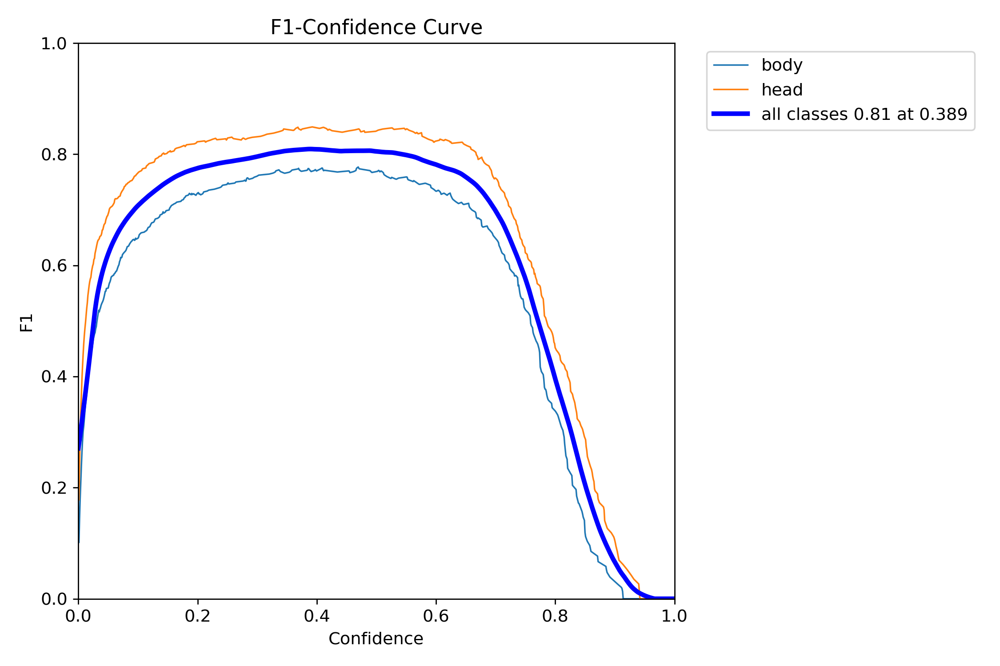

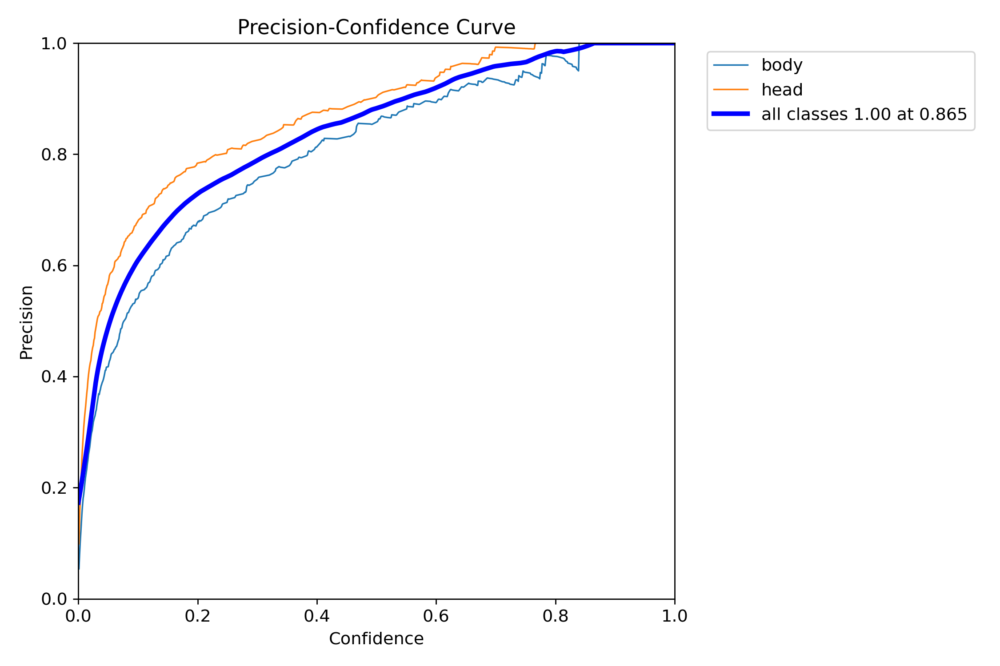

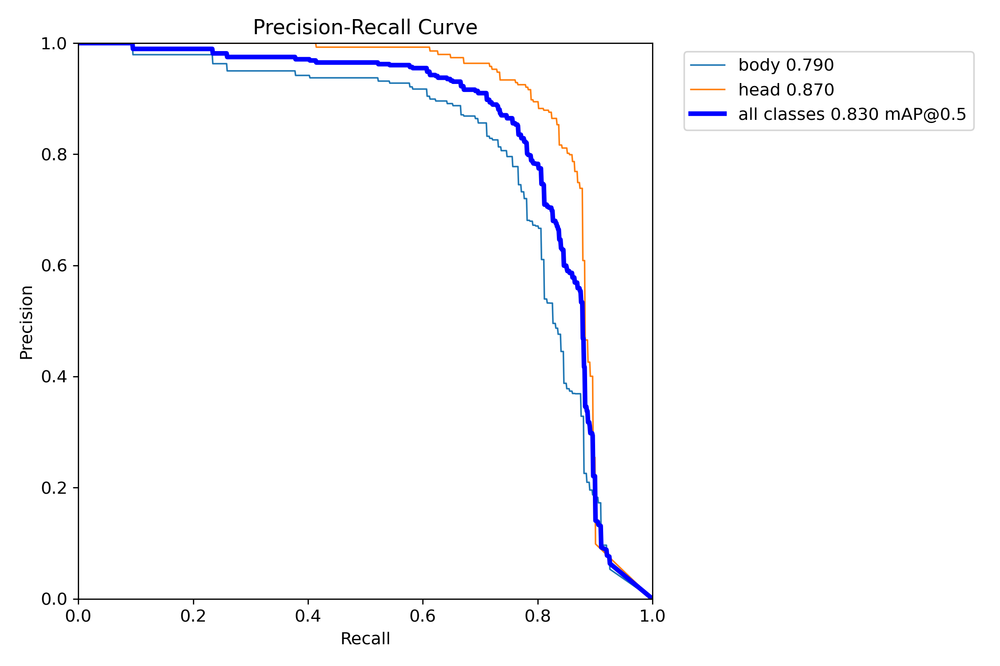

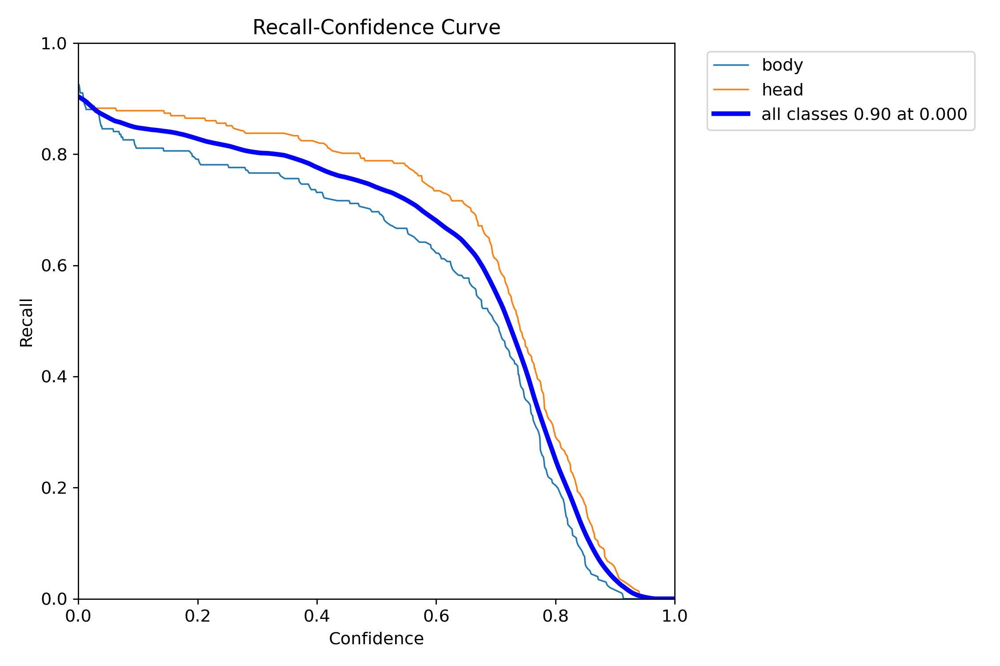

In [ ]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

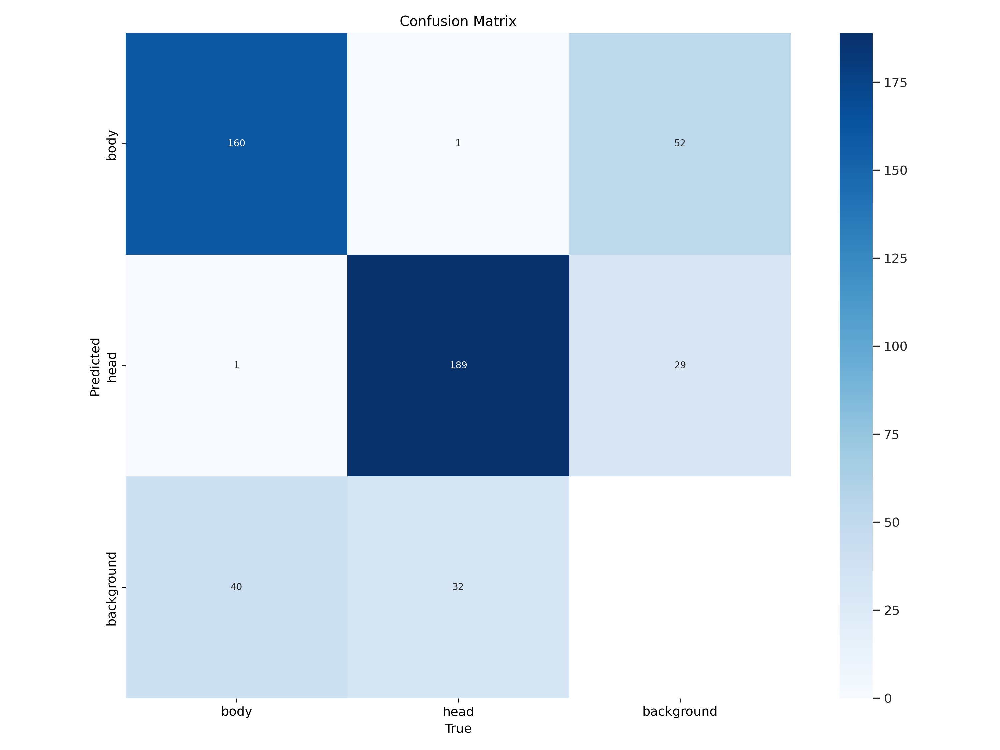

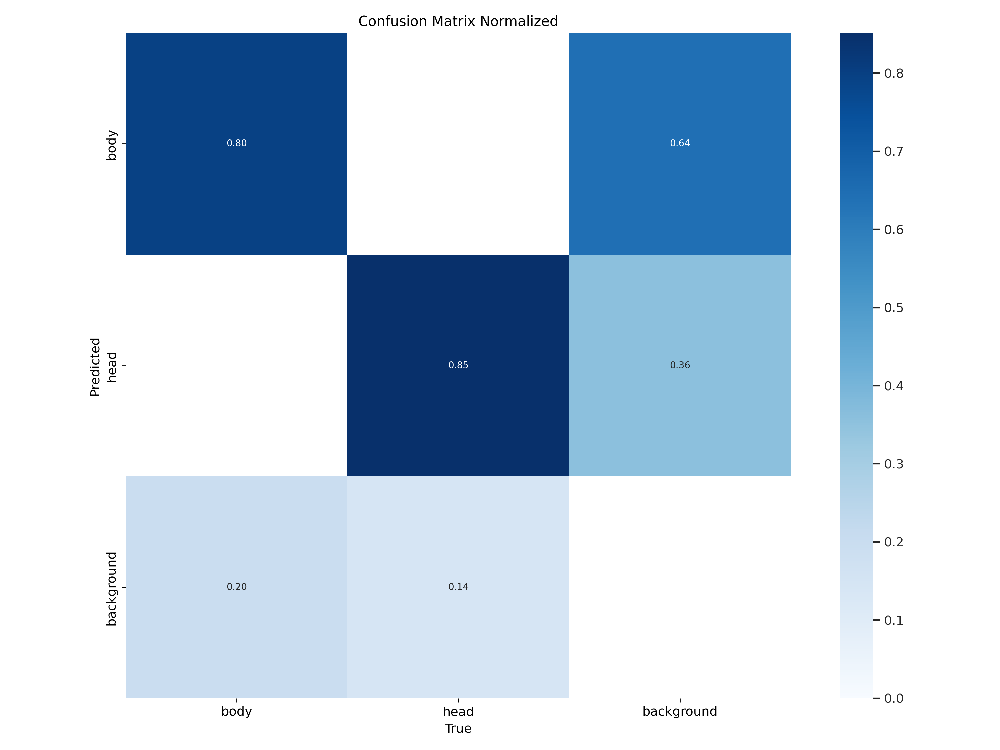

In [ ]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

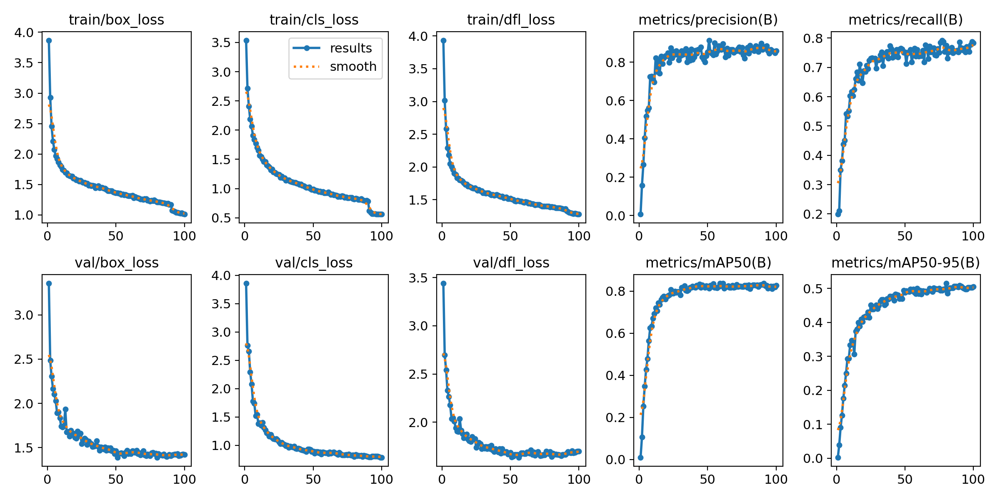

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [ ]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [ ]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 124.1ms
video 1/1 (frame 2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 8.3ms
video 1/1 (frame 3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.3ms
video 1/1 (frame 4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 2 bodys, 1 head, 7.3ms
video 1/1 (frame 5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 2 bodys, 1 head, 7.1ms
video 1/1 (frame 6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x

In [ ]:
!ls 'runs/detect/predict'

sit_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t: 100%|██████████| 303/303 [00:01<00:00, 161.55it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                               

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 119.6ms
video 1/1 (frame 2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 8.1ms
video 1/1 (frame 3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.7ms
video 1/1 (frame 5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 8/308) /content/drive/My Drive/Camera Roll/side_video.mp4

In [ ]:
!ls 'runs/detect/predict2'

side_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/side-body-final/scratch-n.pt")

'/content/drive/My Drive/side-body-final/scratch-n.pt'